In [1]:
from igraph import *
import matplotlib.pyplot as plt
import matplotlib   

import collections
import numpy as np
import pandas as pd
from tqdm import tqdm
import seaborn as sns
from sklearn.linear_model import LinearRegression
import random
import os

In [2]:
seed = 1234
np.random.seed(seed)
random.seed(seed)

In [4]:
def degree_fn(g=None):
    if type(g) is Graph:
        freq = collections.Counter(g.degree())
        for key,value in freq.most_common():
            freq[key] = value/g.vcount()
    elif type(g):
        N = len(g)
        freq = collections.Counter(g)
        for key,value in freq.most_common():
            freq[key] = value/N
        
    k,pk = zip(*sorted(dict(freq).items(),key = lambda x: x[0]))
    return k,pk

# Facebook Network

## 1. Structural Properties of the Facebook Network

### A first look at the network

In [5]:
path = os.path.join(r'C:\Users\lpott\Desktop\UCLA\ECENGR232E-80\project_2\facebook','facebook_combined.txt.gz')
facebook_df = pd.read_csv(path, compression='gzip', header=None, sep=' ', quotechar='"', error_bad_lines=False)

In [6]:
facebook_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 88234 entries, 0 to 88233
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   0       88234 non-null  int64
 1   1       88234 non-null  int64
dtypes: int64(2)
memory usage: 1.3 MB


In [7]:
facebook_df.head()

,0,1
0,0,1
1,0,2
2,0,3
3,0,4
4,0,5


In [8]:
N_check = len(set(facebook_df[0].unique().tolist()).union(set(facebook_df[1].unique().tolist())))

In [9]:
N = facebook_df.values.max()+1

In [10]:
g = Graph()

In [11]:
g.add_vertices(N)

In [12]:
edges = (facebook_df.values).tolist()

In [13]:
g.add_edges(edges)

In [14]:
plot(g,target='images\question1.png',bbox=(500,300),vertex_size=4,edge_width=.1)

### 1.1 Report the number of nodes and number of edges of the Facebook network

In [15]:
N_nodes = g.vcount()
N_edges = g.ecount()
print("Number of Nodes: {:.0f}".format(N_nodes))
print("Number of Edges: {:.0f}".format(N_edges))

Number of Nodes: 4039
Number of Edges: 88234


### 1.2 Is the Facebook network connected? If not, find the giant connected component (GCC) of the network and report the size of the GCC.

In [16]:
is_connected = g.is_connected()
print("The Facebook Graph Connection={:.0f}".format(is_connected))

The Facebook Graph Connection=1


### 2. Find the diameter of the network.

In [17]:
facebook_diameter = g.diameter()
print("The Facebook Graph Diameter={:.0f}".format(facebook_diameter))

The Facebook Graph Diameter=8


### Plot the degree distribution of the facebook network and report the average degree.

In [18]:
k,pk = degree_distribution = degree_fn(g)
degree_mean = g.degree_distribution().mean

In [19]:
print("The Average Degree is {:.3f}".format(degree_mean))

The Average Degree is 43.691


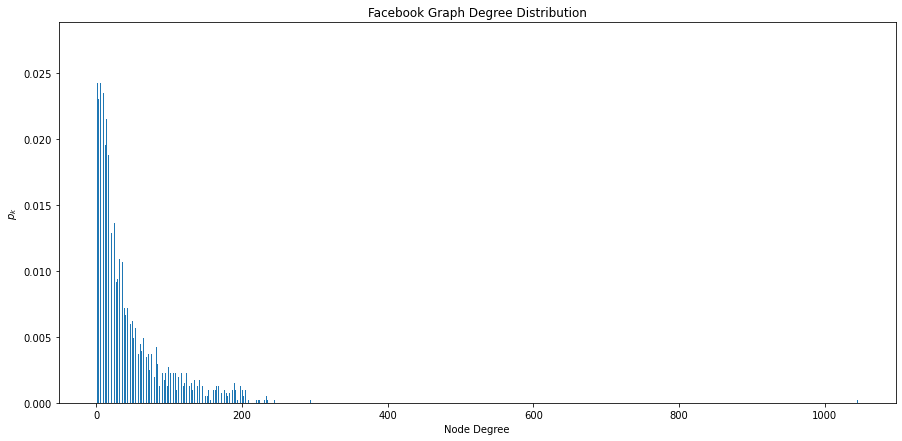

In [20]:
plt.figure(figsize=(15,7))
plt.bar(k,pk,width=0.5)
plt.xlabel("Node Degree"); plt.ylabel("$p_k$"); plt.title("Facebook Graph Degree Distribution")
plt.savefig('images\question3.png')
plt.show()

### Question 4

In [33]:
lmfit = LinearRegression().fit(np.log10(k[10:100]).reshape(-1,1),np.log10(pk[10:100]).reshape(-1,))
slope = lmfit.coef_

In [34]:
print("The slope of the lmfit on log-log plot {:.4f}".format(lmfit.coef_.item()))
print("The intercept of the lmfit on log-log plot {:.4f}".format(lmfit.intercept_))

The slope of the lmfit on log-log plot -1.2485
The intercept of the lmfit on log-log plot -0.1727


In [36]:
k_line = np.array([k[10],k[100]])

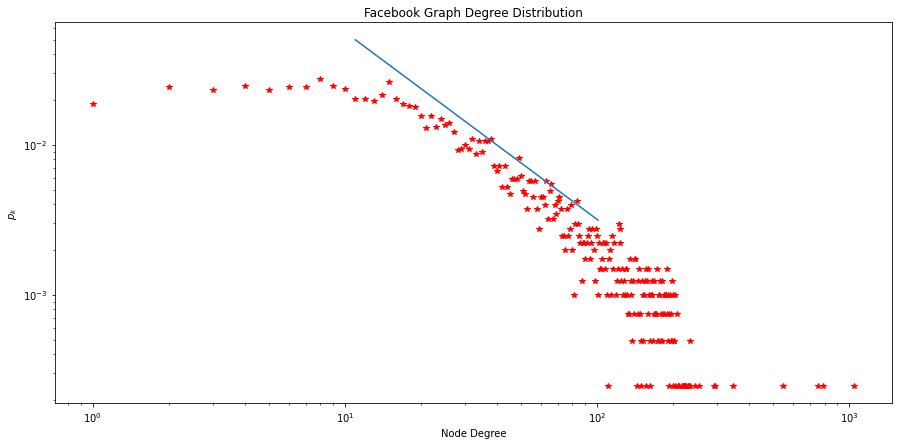

In [40]:
plt.figure(figsize=(15,7))
plt.loglog(k,pk,'r*')
plt.loglog(k_line,k_line**slope)
plt.xlabel("Node Degree"); plt.ylabel("$p_k$"); plt.title("Facebook Graph Degree Distribution")
plt.savefig('images\question4.png')
plt.show()

## 2. Personalized Network

###  Question 5

In [41]:
subset = [0] + [neighbor.index for neighbor in g.vs[0].neighbors()]
g_subset = g.induced_subgraph(subset)

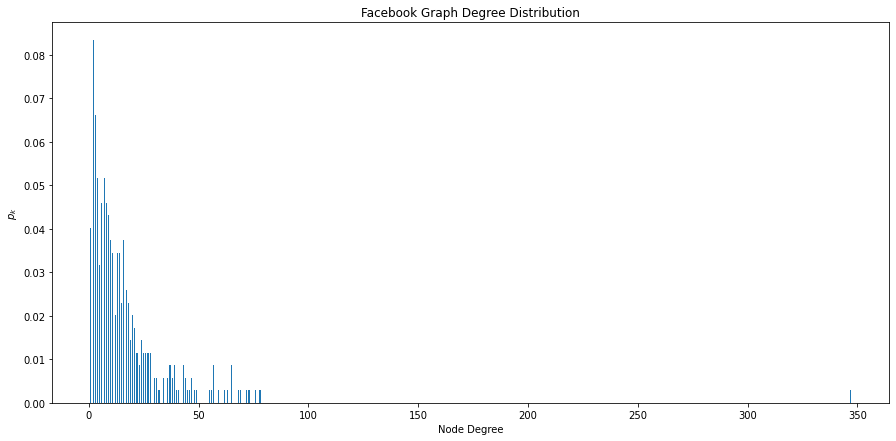

In [42]:
k,pk = degree_distribution = degree_fn(g_subset)

plt.figure(figsize=(15,7))
plt.bar(k,pk,width=0.5)
plt.xlabel("Node Degree"); plt.ylabel("$p_k$"); plt.title("Facebook Graph Degree Distribution")
plt.savefig('images\question5_a.png')
plt.show()

In [43]:
N_nodes = g_subset.vcount()
N_edges = g_subset.ecount()
print("Number of Nodes: {:.0f}".format(N_nodes))
print("Number of Edges: {:.0f}".format(N_edges))

Number of Nodes: 348
Number of Edges: 2866


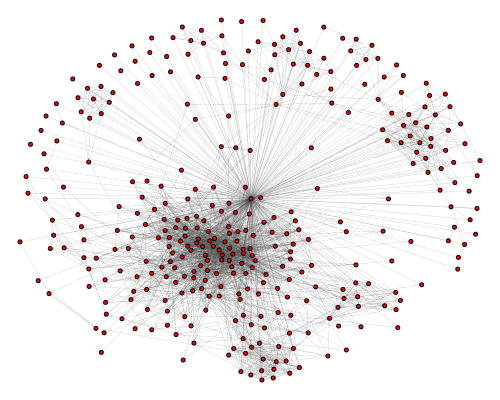

In [44]:
plot(g_subset,target="images\question5_b.png",vertex_size=4,edge_width=0.1,bbox=(500,400))

### Question 6

In [45]:
print("The diameter of the personalized network is {:.0f}".format(g_subset.diameter()))

The diameter of the personalized network is 2


### Question 7

## 3. Core node's personalized network

### Question 8

In [46]:
N_corenodes = np.sum([1 for node in g.vs if len(node.neighbors()) > 200])

### Question 9

In [56]:
node_ids = [0,107,348,483,1086]

In [57]:
f = g_subset.community_infomap()

In [ ]:
for n_id in tqdm(node_ids):
    subset = [n_id] + [neighbor.index for neighbor in g.vs[n_id].neighbors()]
    g_subset = g.induced_subgraph(subset)
    
    clusterings = {"infomap":g_subset.community_infomap(),
                   "fastgreedy":g_subset.community_fastgreedy().as_clustering(),
                   "edge_betweeness":g_subset.community_edge_betweenness().as_clustering()
                  }
    
    target = "images\Question9_nodeid{:.0f}_".format(n_id)
    for cluster_type,cluster in clusterings.items():
        filename =  target+cluster_type+".png" 
        plot(cluster,target=filename,bbox=(0,0,500,300),vertex_size=6,edge_size=0.5)    